# Getting the latent space of pre-trained models and predict task


## Importing the functions & libraries

In [9]:
import os
ml_code_path='/home/leilapirhaji/mz_embed_engine/ml'
os.chdir(ml_code_path)

import pandas as pd
import importlib
from sklearn.preprocessing import LabelEncoder
label_encoder = LabelEncoder()
import optuna
import imaplib

import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
import umap
import seaborn as sns

import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import TensorDataset, DataLoader
import pandas as pd
import numpy as np
import random
from sklearn.metrics import precision_score, recall_score, f1_score, roc_auc_score, accuracy_score


from pretrain_neptune.get_pretrain_encoder import get_pretrain_encoder_from_modelID, get_pretrain_input_data
from pretrain.latent_task_predict import log_reg_multi_class, ridge_regression_predict


%who



DataLoader	 LabelEncoder	 PCA	 TensorDataset	 X_data_all	 X_data_test	 X_data_train	 X_data_val	 Z_all	 
Z_test	 Z_train	 Z_val	 accuracy_score	 f1_score	 filter_and_plot_cat	 filter_and_plot_num	 generate_latent_space	 get_pretrain_encoder_from_local	 
get_pretrain_encoder_from_modelID	 get_pretrain_input_data	 imaplib	 importlib	 input_data_location	 label_encoder	 latent_passes	 latent_rep_all	 log_reg_multi_class	 
ml_code_path	 model_folder	 nn	 np	 optim	 optuna	 os	 pd	 plt	 
precision_score	 pretrain	 pretrain_id	 pretrain_name	 pretrain_save_dir	 pretrain_trial_list	 pretrain_vae	 random	 recall_score	 
ridge_regression_predict	 roc_auc_score	 sns	 task	 torch	 umap	 y_data_all	 y_data_test	 y_data_train	 
y_data_val	 


## Necessary functions

In [3]:
# Function to filter and plot categorical data
def filter_and_plot_cat(Z_reduced, y_data, data_label, task, ax, palette='tab10', method='UMAP'):
    valid_rows = y_data[[task]].dropna().index
    # Convert valid_rows into integer indices that NumPy arrays understand
    valid_indices = [y_data.index.get_loc(idx) for idx in valid_rows]
    Z_filtered = Z_reduced[valid_indices]
    y_filtered = y_data.loc[valid_rows, task]

    # Count the number of samples for each category
    category_counts = y_filtered.value_counts().to_dict()

    # Create a custom legend label with sample counts
    custom_legend_labels = [f'{cat}: {count} samples' for cat, count in category_counts.items()]

    # Plot the reduced data with smaller dots and transparency for categorical data
    sns.scatterplot(x=Z_filtered[:, 0], y=Z_filtered[:, 1], hue=y_filtered, palette=palette, s=10, alpha=0.5, ax=ax)

    # Title with the total number of samples
    ax.set_title(f"{data_label} colored by {task} (n={len(valid_rows)})", fontsize=20)
    ax.set_xlabel(f'{method} Component 1', fontsize=18)
    ax.set_ylabel(f'{method} Component 2', fontsize=18)

    # Update the legend with sample counts
    handles, labels = ax.get_legend_handles_labels()
    ax.legend(handles, custom_legend_labels, title=f"{task} (n={len(valid_rows)})", bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=12, title_fontsize=14)


# Function to filter and plot numerical data
def filter_and_plot_num(Z_reduced, y_data, data_label, task, ax, method='UMAP'):
    valid_rows = y_data[[task]].dropna().index
    # Convert valid_rows into integer indices that NumPy arrays understand
    valid_indices = [y_data.index.get_loc(idx) for idx in valid_rows]
    Z_filtered = Z_reduced[valid_indices]
    y_filtered = y_data.loc[valid_rows, task]
    
    BMI_cap=40

    # Special handling for BMI: cap the values at 40 for better visualization
    if task == 'BMI':
        y_filtered_capped = y_filtered.copy()
        y_filtered_capped = np.where(y_filtered_capped > BMI_cap, BMI_cap, y_filtered_capped)  # Cap BMI values at 40
        scatter = ax.scatter(Z_filtered[:, 0], Z_filtered[:, 1], c=y_filtered_capped, cmap='coolwarm', s=10, alpha=0.5)
        plt.colorbar(scatter, ax=ax, label=f"{task} (capped at {BMI_cap})")
    else:
        scatter = ax.scatter(Z_filtered[:, 0], Z_filtered[:, 1], c=y_filtered, cmap='coolwarm', s=10, alpha=0.5)
        plt.colorbar(scatter, ax=ax, label=task)

    # Title with the total number of samples
    ax.set_title(f"{data_label} colored by {task} (n={len(valid_rows)})", fontsize=20)
    ax.set_xlabel(f'{method} Component 1', fontsize=18)
    ax.set_ylabel(f'{method} Component 2', fontsize=18)


## Importing the input datasets

In [4]:
# getting the input data
input_data_location='/home/leilapirhaji/PROCESSED_DATA_S_8.1.1'
(X_data_all, y_data_all, X_data_train, y_data_train, X_data_val, y_data_val, X_data_test, y_data_test)=  get_pretrain_input_data(input_data_location)

X_data_all.shape, y_data_all.shape, X_data_train.shape, y_data_train.shape, X_data_val.shape, y_data_val.shape, X_data_test.shape, y_data_test.shape

/home/leilapirhaji/mz_embed_engine/ml/pretrain_neptune/get_pretrain_encoder.py:72: DtypeWarning: Columns (1,8,28,30,31,32,33,34,46,50,51,52,53,54,55,56,57,58) have mixed types. Specify dtype option on import or set low_memory=False.
  y_data_all = pd.read_csv(pretrain_y_all, index_col=0)
/home/leilapirhaji/mz_embed_engine/ml/pretrain_neptune/get_pretrain_encoder.py:75: DtypeWarning: Columns (1,8,14,15,24,25,26,28,29,30,31,32,33,34,46,50,51,52,53,54,55,56,57,58) have mixed types. Specify dtype option on import or set low_memory=False.
  y_data_train = pd.read_csv(pretrain_y_train, index_col=0)


((20548, 2736),
 (20548, 58),
 (17465, 2736),
 (17465, 58),
 (2055, 2736),
 (2055, 58),
 (1028, 2736),
 (1028, 58))

## get pretrain model

In [10]:
import importlib
import pretrain.get_pretrain_encoder
importlib.reload(pretrain.get_pretrain_encoder)
from pretrain.get_pretrain_encoder import get_pretrain_encoder_from_local

pretrain_save_dir='/home/leilapirhaji/pretrained_models'
pretrain_name='pretrain_VAE_L_400_425_e_400_p_25_s_8.1.1'
pretrain_trial_list=[143]
pretrain_id=pretrain_trial_list[0]

(pretrain_vae, Z_train, Z_val, Z_test)=get_pretrain_encoder_from_local(pretrain_name, pretrain_id, pretrain_save_dir)
pretrain_vae

VAE(
  (encoder): Dense_Layers(
    (network): Sequential(
      (0): Linear(in_features=2736, out_features=1524, bias=True)
      (1): LeakyReLU(negative_slope=0.01)
      (2): Dropout(p=0.1, inplace=False)
      (3): Linear(in_features=1524, out_features=850, bias=True)
      (4): LeakyReLU(negative_slope=0.01)
      (5): Dropout(p=0.1, inplace=False)
      (6): Linear(in_features=850, out_features=850, bias=True)
    )
  )
  (decoder): Dense_Layers(
    (network): Sequential(
      (0): Linear(in_features=425, out_features=850, bias=True)
      (1): LeakyReLU(negative_slope=0.01)
      (2): Dropout(p=0.1, inplace=False)
      (3): Linear(in_features=850, out_features=1524, bias=True)
      (4): LeakyReLU(negative_slope=0.01)
      (5): Dropout(p=0.1, inplace=False)
      (6): Linear(in_features=1524, out_features=2736, bias=True)
    )
  )
)

## gettign the latent space for all input data

In [12]:
from pretrain.eval_pretrained_VAE import generate_latent_space
latent_passes=20

model_folder=f'{pretrain_save_dir}/{pretrain_name}/trial_{pretrain_id}'

# Z_all=[]

# for _ in range(latent_passes):  # Generate multiple latent representations   
#         # Convert DataFrames to Tensors
#         latent_rep_all = torch.tensor(generate_latent_space(X_data_all, pretrain_vae).values, dtype=torch.float32)
#         Z_all.append(latent_rep_all)


# # Averaging the latent spaces
# Z_all = torch.mean(torch.stack(Z_all), dim=0)

# #now converting the latent space to dataframe
# Z_all = pd.DataFrame(Z_all, index=X_data_all.index)

# #save to csv
# Z_all.to_csv(f'{model_folder}/Z_all_avg_{latent_passes}.csv')

Z_all= pd.read_csv(f'{model_folder}/Z_all_avg_{latent_passes}.csv', index_col=0)

Z_all.shape


(20548, 425)

In [13]:
print (Z_all.shape, Z_train.shape, Z_val.shape, Z_test.shape, y_data_all.shape, y_data_train.shape, y_data_val.shape, y_data_test.shape)

(20548, 425) (17465, 425) (2055, 425) (1028, 425) (20548, 58) (17465, 58) (2055, 58) (1028, 58)


## visulaizeing Latent space

In [ ]:
import pretrain.get_pretrain_encoder
importlib.reload(pretrain.get_pretrain_encoder)
from pretrain.get_pretrain_encoder import visualize_latent_space_multiple_tasks

model_id=f'trial_{pretrain_id}'

visualize_latent_space_multiple_tasks( model_id, model_folder, Z_all, Z_train, Z_val, Z_test, y_data_all, y_data_train, y_data_val, y_data_test, method='UMAP', n_components=2, dpi=300, palette='tab10')

## Z-all Visualization

In [17]:
reducer = umap.UMAP(n_components=2)
Z_reduced_all = reducer.fit_transform(Z_all)
Z_reduced_all.shape

(20548, 2)

In [ ]:
#Availbe taks for pre-trained meta-data
task_list_cat=[ 'Study ID', 'is Female', 'is Pediatric', 'Cohort Label v0','Smoking Status', 'Cancer Risk' ]  # List of categorical tasks
task_list_num = ['BMI', 'Age']  # List of numerical tasks


num_tasks = len(task_list_cat) + len(task_list_num)
fig, axs = plt.subplots(8, 1, figsize=(10, 25), dpi=300)  # Adjusted figsize for square subplots

# Plot for categorical tasks
for i, task in enumerate(task_list_cat):
    filter_and_plot_cat(Z_reduced_all, y_data_all, 'All Combined', task, axs[i])

# Plot for numerical tasks
for i, task in enumerate(task_list_num, start=len(task_list_cat)):
    filter_and_plot_num(Z_reduced_all, y_data_all, 'All Combined', task, axs[i])
    
plt.tight_layout()


## plot one task

In [55]:
#Availbe taks for pre-trained meta-data
task_list_cat=[ 'Study ID', 'is Female', 'is Pediatric', 'Cohort Label v0','Smoking Status', 'Cancer Risk' ]  # List of categorical tasks
task_list_num = ['BMI', 'Age']  # List of numerical tasks

In [35]:
reducer = umap.UMAP(n_components=2, n_neighbors=50, min_dist=0.75, n_epochs=1000)
Z_reduced_all = reducer.fit_transform(Z_all)
Z_reduced_all.shape

(20548, 2)

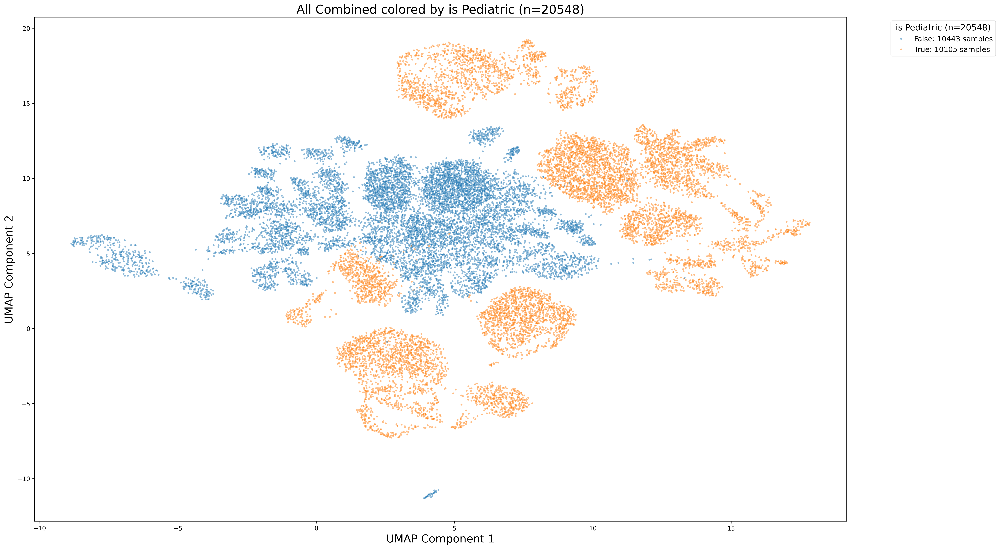

In [38]:
task='is Pediatric'
fig, axs = plt.subplots(figsize=(24,15), dpi=300)  # Adjusted figsize for square subplots
filter_and_plot_cat(Z_reduced_all, y_data_all, 'All Combined', task, axs)
fig.savefig(f'{model_folder}/UMAP_{task}.png', bbox_inches='tight')

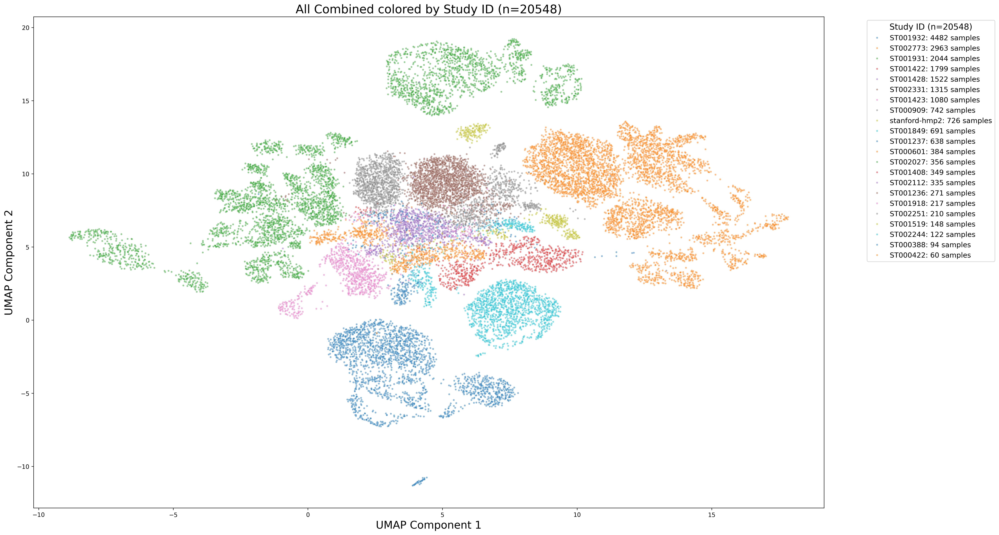

In [39]:
task='Study ID'
fig, axs = plt.subplots(figsize=(24,15), dpi=300)  # Adjusted figsize for square subplots
filter_and_plot_cat(Z_reduced_all, y_data_all, 'All Combined', task, axs)
fig.savefig(f'{model_folder}/UMAP_{task}.png', bbox_inches='tight')

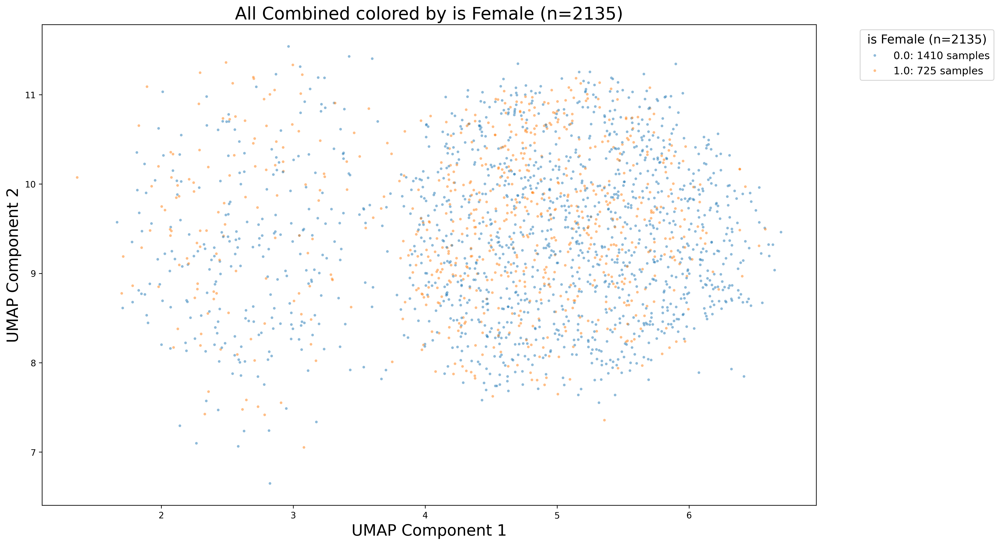

In [40]:
task='is Female'
fig, axs = plt.subplots(figsize=(16,10), dpi=300)  # Adjusted figsize for square subplots
filter_and_plot_cat(Z_reduced_all, y_data_all, 'All Combined', task, axs)
fig.savefig(f'{model_folder}/UMAP_{task}.png', bbox_inches='tight')

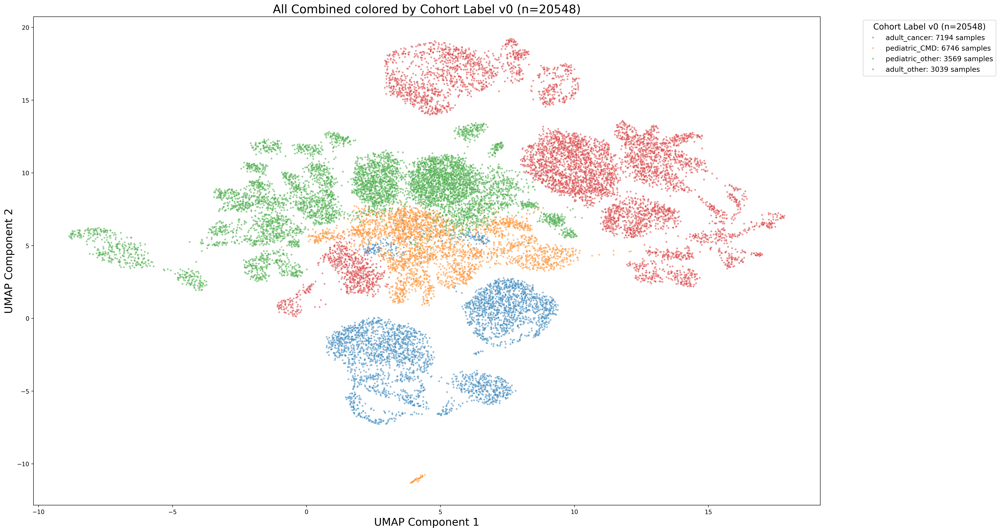

In [41]:
task='Cohort Label v0'
fig, axs = plt.subplots(figsize=(24,15), dpi=300)  # Adjusted figsize for square subplots
filter_and_plot_cat(Z_reduced_all, y_data_all, 'All Combined', task, axs)
fig.savefig(f'{model_folder}/UMAP_{task}.png', bbox_inches='tight')

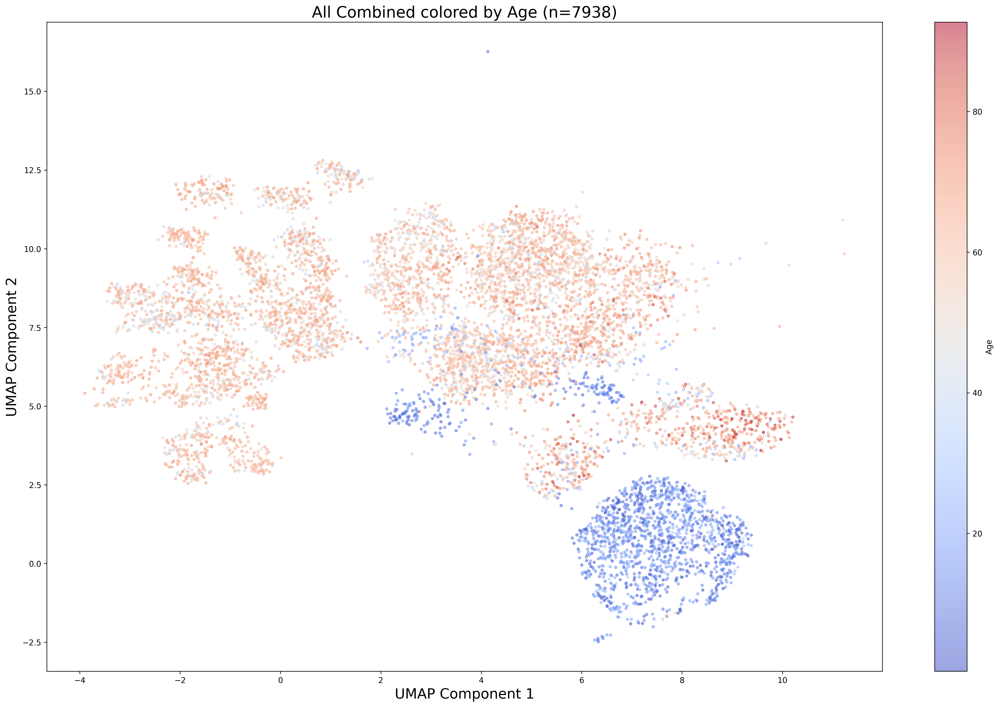

In [42]:
task='Age'
fig, axs = plt.subplots(figsize=(24,15), dpi=300)  # Adjusted figsize for square subplots
filter_and_plot_num(Z_reduced_all, y_data_all, 'All Combined', task, axs)
#axs.set_ylim(-4.5, None)  # y-axis limits, lower bound of -4, no upper bound
#plt.tight_layout()
fig.savefig(f'{model_folder}/UMAP_{task}.png', bbox_inches='tight')

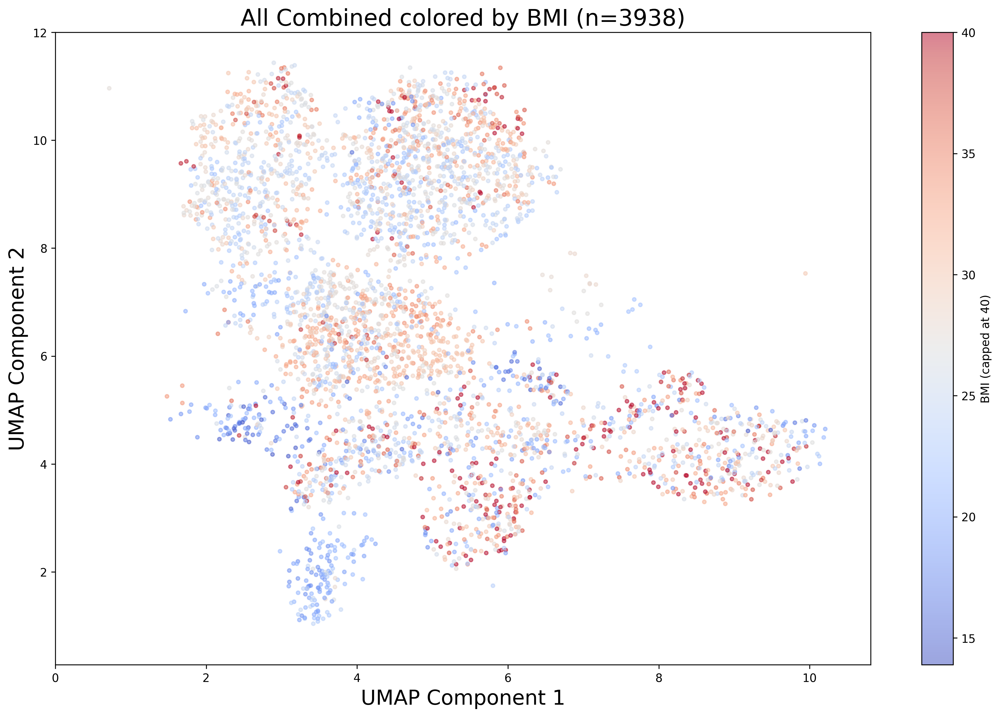

In [44]:
task='BMI'

# Plot the filtered data
fig, axs = plt.subplots(figsize=(16, 10), dpi=300)
filter_and_plot_num(Z_reduced_all, y_data_all, 'All Combined', task, axs)

# # Set the x and y axis limits
axs.set_xlim(0, None)  # x-axis limits, lower bound of 2, no upper bound
axs.set_ylim(None, 12)  # y-axis limits, lower bound of -4, no upper bound
fig.savefig(f'{model_folder}/UMAP_{task}.png', bbox_inches='tight')